#**Lab3: Sound Effects **

Nội dung của bài thực hành này là thiết kế hệ thống xử lý tín hiệu trong miền tần số và trong miền thời gian, thông qua việc thiết kế và sử dụng các bộ lọc thích hợp.


**Sound Equalization:**
Là một ví dụ cơ bản về xử lý trong miền tần số. Dựa vào tính chất của đáp ứng tần số của hệ thống ta có thể "control" được độ lớn của mỗi thành phần tần số ở phía lối ra. Một hệ EQ gồm các bộ lọc thông dải và trọng số gán cho mỗi dải tần số đó. Thay đổi trọng số, ta có thể thay đổi độ lớn của âm trong mỗi dải tần. Do vậy, khi nguồn âm thanh (sound source) vốn là tổ hợp của nhiều dải tần số đi qua bộ EQ, các tín hiệu âm thanh mới sẽ được tạo ra. Cụ thể ta sẽ thực hiện bộ EQ theo hướng dẫn ở bên dưới

Link một số file audio để test:

https://www.dropbox.com/scl/fo/wgxfhkkfv3cogj49cuc1c/AM4z1o7SKyXYOs-fG8ymojk?rlkey=1w97y3yzg27uar90qo9mc6wyz&dl=0


#Phần 1: Tìm hiểu về các bộ lọc trong python

In [ ]:
#Để thiết kế các bộ lọc FIR hoặc IIR ta dùng các hàm trong thư viện scipy.signal:
from scipy.signal  import firwin
## firwin(numtaps, cutoff, *, width=None, window='hamming', pass_zero=True, scale=True, fs=None)[source]
numtaps = 11 # bậc của bộ lọc
fc = 0.2  # tần số chuẩn hoá, fs/2 =  1

hLP_FIR=firwin(numtaps, fc)
hLP_FIR

array([7.39142315e-19, 9.30428315e-03, 4.75777661e-02, 1.22363546e-01,
       2.02246558e-01, 2.37015692e-01, 2.02246558e-01, 1.22363546e-01,
       4.75777661e-02, 9.30428315e-03, 7.39142315e-19])

In [ ]:
# Trong trường hợp cần chuẩn hoá các tham số hoặc chọn cửa sổ :

from scipy.signal import kaiserord, lfilter, firwin, freqz
# The Nyquist rate of the signal.
fs=50
nyq_rate = fs / 2.0
# The cutoff frequency of the filter.
cutoff_hz = 10.0

# The desired width of the transition from pass to stop,
# relative to the Nyquist rate.  We'll design the filter
# with a 5 Hz transition width.

width = 5.0/nyq_rate

# The desired attenuation in the stop band, in dB.
ripple_db = 60.0

# Compute the order and Kaiser parameter for the FIR filter.
N, beta = kaiserord(ripple_db, width)

# Use firwin with a Kaiser window to create a lowpass FIR filter.
hLP_FIR1 = firwin(N, cutoff_hz/nyq_rate, window=('kaiser', beta))

hLP_FIR1




array([-3.33564605e-04,  6.46619611e-19,  1.28513257e-03,  1.28816193e-03,
       -1.95847055e-03, -4.60069485e-03,  4.15375822e-18,  8.80733324e-03,
        7.27704786e-03, -9.57486898e-03, -2.01545287e-02,  1.00620313e-17,
        3.36257821e-02,  2.69924578e-02, -3.56480803e-02, -7.88408723e-02,
        1.48742219e-17,  1.98407645e-01,  3.73427520e-01,  3.73427520e-01,
        1.98407645e-01,  1.48742219e-17, -7.88408723e-02, -3.56480803e-02,
        2.69924578e-02,  3.36257821e-02,  1.00620313e-17, -2.01545287e-02,
       -9.57486898e-03,  7.27704786e-03,  8.80733324e-03,  4.15375822e-18,
       -4.60069485e-03, -1.95847055e-03,  1.28816193e-03,  1.28513257e-03,
        6.46619611e-19, -3.33564605e-04])

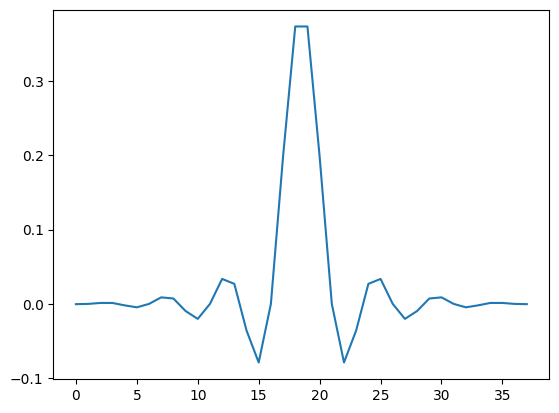

In [ ]:
# Ta có thể hiển thị đáp ứng xung của bộ lọc trong miền thời gian:
import matplotlib.pyplot as plt
plt.plot(hLP_FIR1)
plt.show()



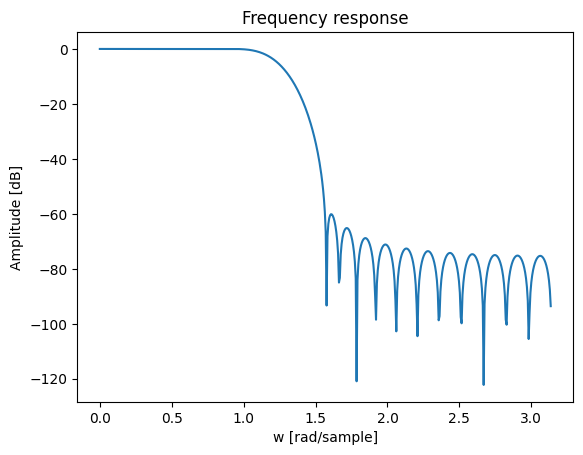

In [ ]:
# Để vẽ đáp ứng tần số của bộ lọc, ta dùng lệnh freqz:

from scipy import signal
import numpy as np
w, h = signal.freqz(hLP_FIR1)
plt.plot(w, 20 * np.log10(abs(h)))
plt.title('Frequency response')
plt.ylabel('Amplitude [dB]')
plt.xlabel('w [rad/sample]')

plt.show()

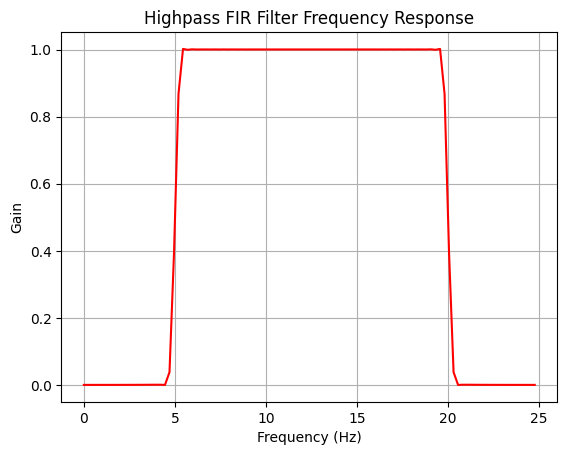

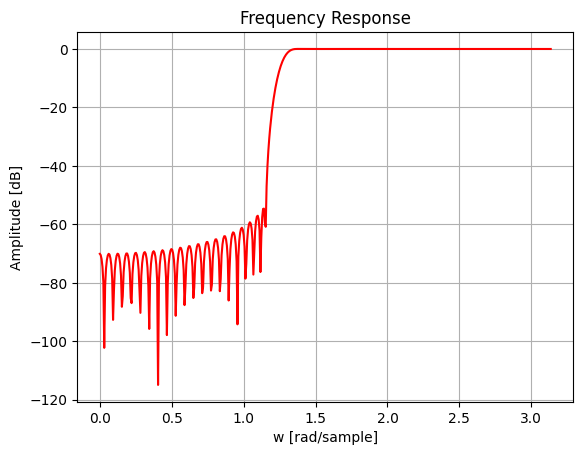

In [ ]:
# Để thực hiện bộ lọc Highpass:

# Code here
import numpy as np
from scipy.signal import firwin, lfilter, freqz
import matplotlib.pyplot as plt

# Parameters
fs = 50  # Sampling frequency (Hz)
nyq_rate = fs / 2.0  # Nyquist frequency (half of the sampling rate)
cutoff_freq = 10.0  # Cutoff frequency for the highpass filter (Hz)
beta = 5.0  # Beta parameter for the Kaiser window (controls the window shape)
num_taps = 101  # Number of filter coefficients (filter length)

# Create a highpass FIR filter using the Kaiser window
hHP_FIR1 = firwin(num_taps, cutoff_freq / nyq_rate, window=('kaiser', beta), pass_zero=False)

# Create an array of frequency values for the x-axis
w = np.linspace(0, nyq_rate, num_taps, endpoint=False)

# Compute the magnitude of the filter's frequency response using FFT
h = np.abs(np.fft.fft(hHP_FIR1, num_taps))

# Plot the filter's frequency response using red color
plt.plot(w, h, color='red')
plt.title('Highpass FIR Filter Frequency Response')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Gain')
plt.grid()
plt.show()

# Compute and plot the frequency response using freqz
w, h = freqz(hHP_FIR1, worN=512)

# Plot the amplitude response in dB using red color
plt.plot(w, 20 * np.log10(abs(h)), color='red')
plt.title('Frequency Response')
plt.ylabel('Amplitude [dB]')
plt.xlabel('w [rad/sample]')
plt.grid()
plt.show()





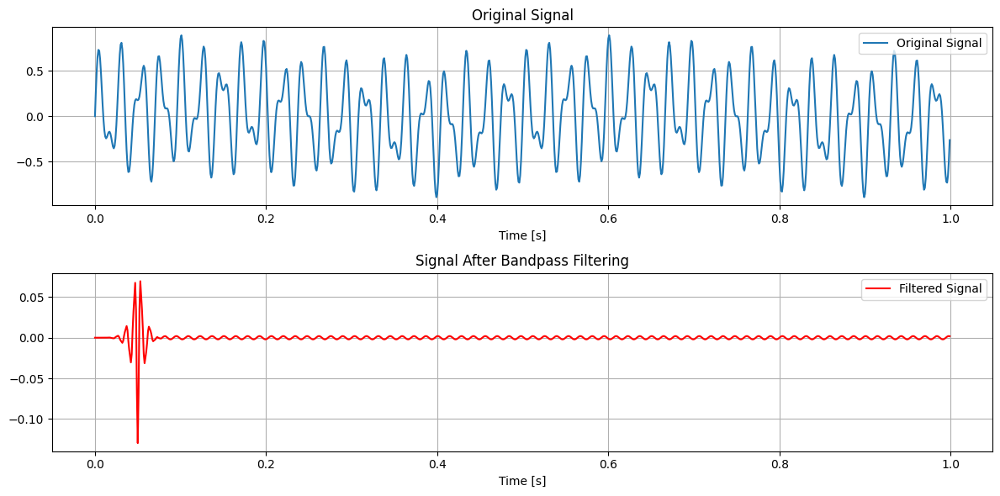

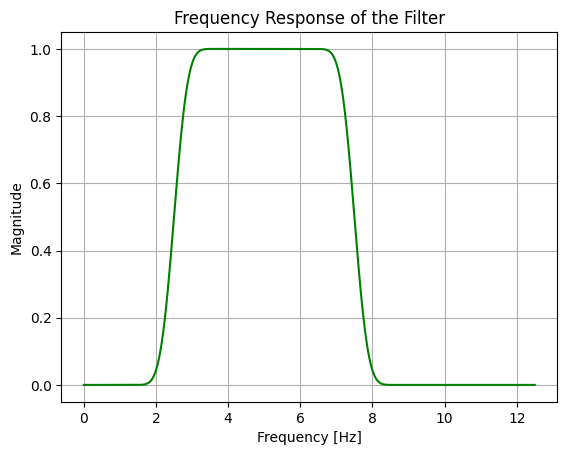

In [ ]:
# Để thực hiện bộ lọc Bandpass:

import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import firwin, lfilter, freqz

# Parameters
fs = 50  # Sampling frequency (Hz)
nyq_rate = fs / 2  # Nyquist frequency (half of sampling rate)
lowcut = 5.0  # Lower cutoff frequency for bandpass filter (Hz)
highcut = 15.0  # Upper cutoff frequency for bandpass filter (Hz)
numtaps = 101  # Number of filter coefficients (filter length)
beta = 14  # Beta parameter for the Kaiser window (controls window shape)

# Calculate the filter coefficients for the bandpass FIR filter
hBP_FIR1 = firwin(numtaps, [lowcut, highcut], pass_zero=False, fs=nyq_rate*2, window=('kaiser', beta))

# Create a sample signal for testing
t = np.linspace(0, 1.0, 1000, endpoint=False)  # Time vector for 1 second

# Signal components with different frequencies
a = 0.1 * np.sin(2 * np.pi * 2 * t)  # Signal component at 2 Hz
b = 0.5 * np.sin(2 * np.pi * 42 * t)  # Signal component at 10 Hz
c = 0.3 * np.sin(2 * np.pi * 72 * t)  # Signal component at 20 Hz

# Combine signal components into a composite signal
x = a + b + c
#Apply filter
filtered_x = lfilter(hBP_FIR1, 1.0, x)

# PLot  bộ lọc trong miền thời gian và tần số
# Code here....
plt.figure(figsize=(12, 6))

# Original signal
plt.subplot(2, 1, 1)
plt.plot(t, x, label='Original Signal')
plt.title('Original Signal')
plt.xlabel('Time [s]')
plt.grid()
plt.legend()

# Filtered signal
plt.subplot(2, 1, 2)
plt.plot(t, filtered_x, label='Filtered Signal', color='red')  # Changed color to red
plt.title('Signal After Bandpass Filtering')
plt.xlabel('Time [s]')
plt.grid()
plt.legend()

plt.tight_layout()  # Adjusts subplots to fit into figure area
plt.show()

# Frequency response of the filter
w, h = freqz(hBP_FIR1, worN=8000)
plt.figure()
plt.plot(0.5 * nyq_rate * w / np.pi, np.abs(h), 'g')
plt.title('Frequency Response of the Filter')
plt.xlabel('Frequency [Hz]')
plt.ylabel('Magnitude')
plt.grid()
plt.show()



<ipython-input-7-f60beee08357>:20: MatplotlibDeprecationWarning: The 'use_line_collection' parameter of stem() was deprecated in Matplotlib 3.6 and will be removed two minor releases later. If any parameter follows 'use_line_collection', they should be passed as keyword, not positionally.
  plt.stem(hBS_FIR1, use_line_collection=True)  # Plot the filter coefficients


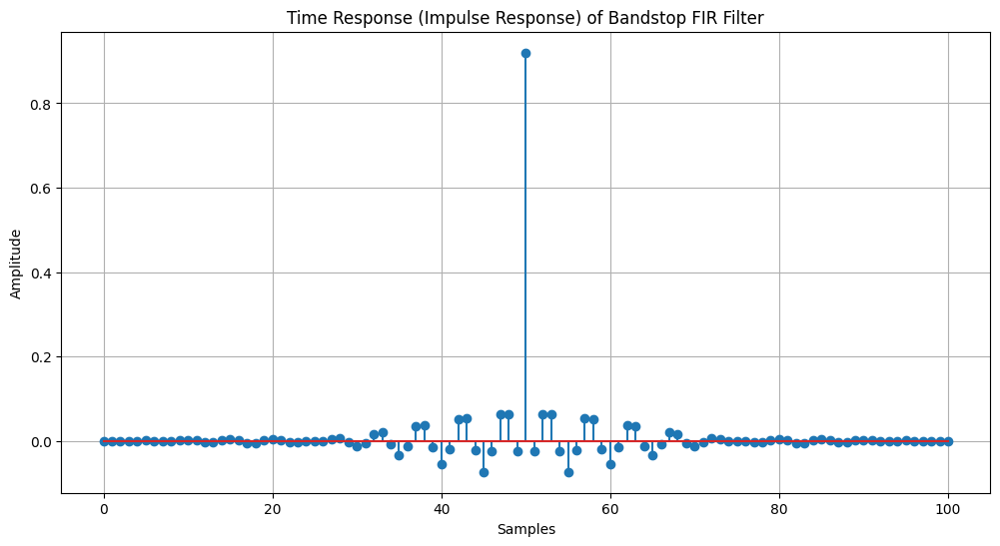

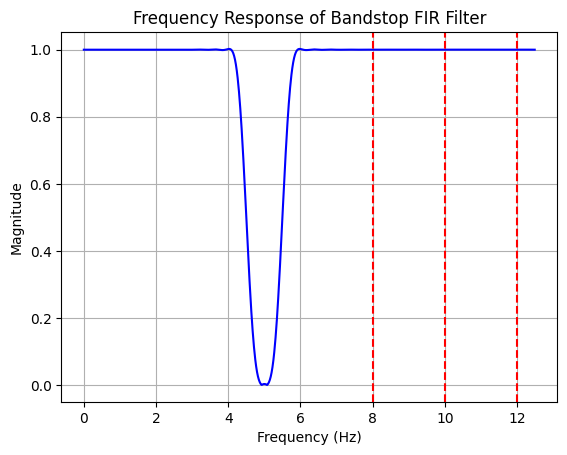

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import firwin, lfilter, freqz

# Set parameters
fs = 50  # Sampling frequency (Hz)
nyq_rate = fs / 2  # Nyquist frequency (half of the sampling rate)
cutoff = 10.0   # Cutoff frequency (Hz)
bandwidth = 2.0 # Bandwidth for the bandstop filter (Hz)
beta = 5.0  # Beta parameter for the Kaiser window (controls window shape)

# Calculate the number of filter coefficients
numtaps = 101  # Number of coefficients for the FIR filter

# Create the bandstop FIR filter using firwin with a Kaiser window
hBS_FIR1 = firwin(numtaps, [cutoff - bandwidth/2, cutoff + bandwidth/2], pass_zero='bandstop', fs=2*nyq_rate, window=('kaiser', beta))

# Plot the time-domain response (Impulse Response)
plt.figure(figsize=(12, 6))
plt.stem(hBS_FIR1, use_line_collection=True)  # Plot the filter coefficients
plt.title('Time Response (Impulse Response) of Bandstop FIR Filter')
plt.xlabel('Samples')
plt.ylabel('Amplitude')
plt.grid()

# Show the time-domain response
plt.show()

# Compute the frequency response of the filter
w, h = freqz(hBS_FIR1, worN=1024)

# Plot the frequency response
plt.plot(0.5 * nyq_rate * w / np.pi, np.abs(h), 'b')
plt.title('Frequency Response of Bandstop FIR Filter')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.grid()

# Add vertical lines at the cutoff frequencies and bandwidth
plt.axvline(cutoff, color='r', linestyle='--')
plt.axvline(cutoff + bandwidth, color='r', linestyle='--')
plt.axvline(cutoff - bandwidth, color='r', linestyle='--')

# Show the frequency response
plt.show()


In [ ]:
# Bây giờ sử dụng bộ lọc IIR:
# Tìm hiểu cách sử dụng hàm iirfilter hoặc butterworth, chebysev... để thiết kế bộ lọc thích hợp
# Vẽ đáp ứng của bộ lọc trong miền thời gian và tần số...



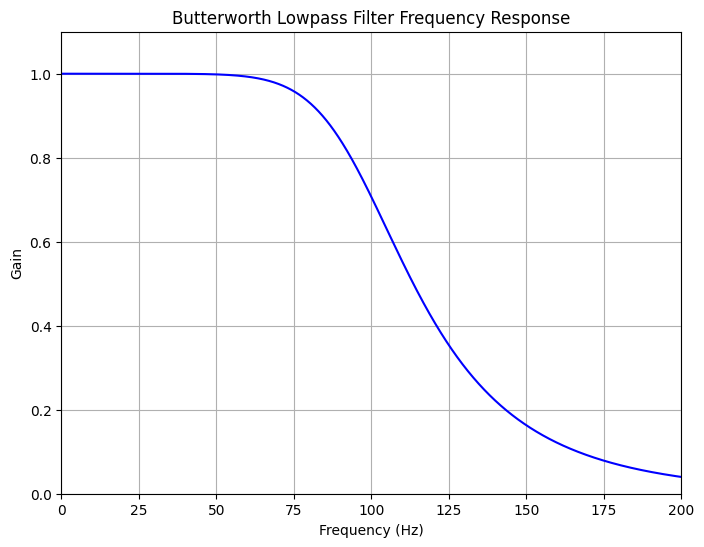

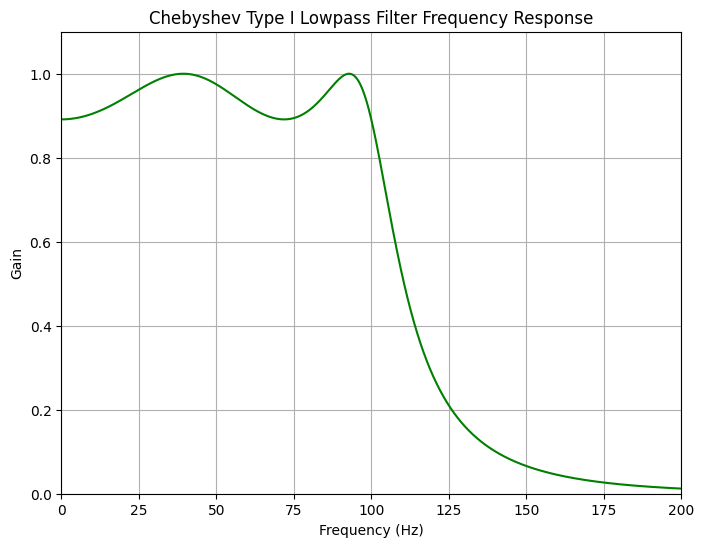

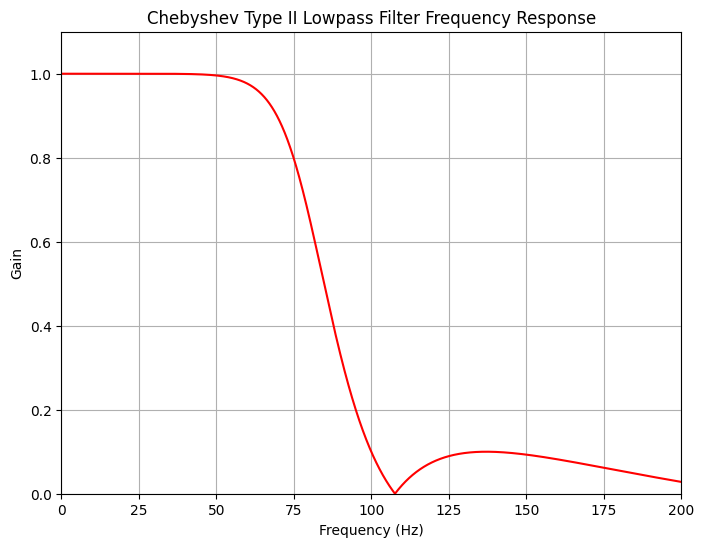

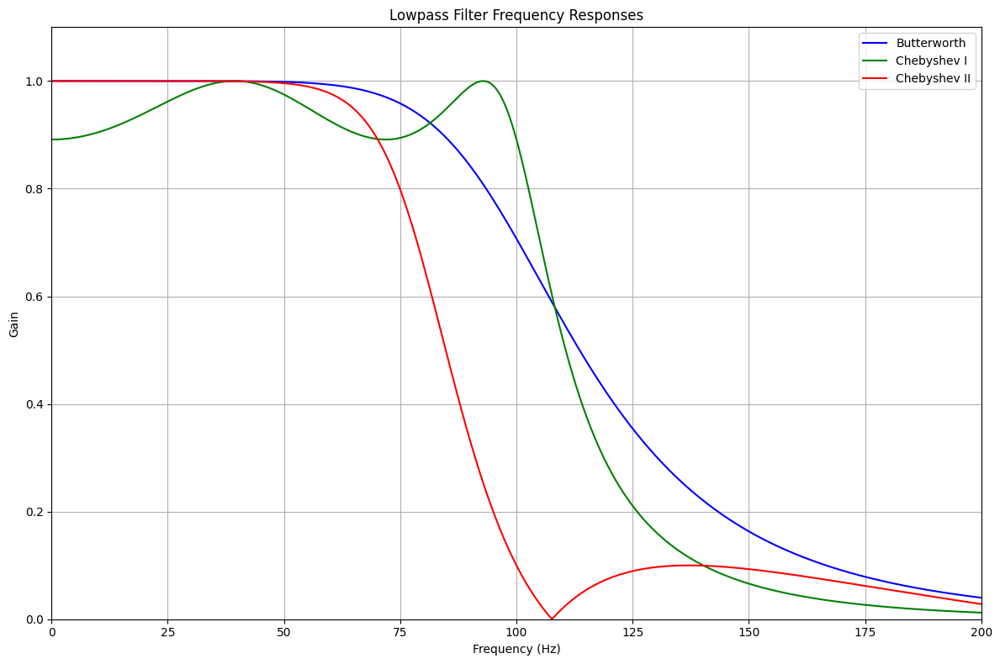

In [ ]:
#IIR lowpass sử dụng Butterworth và ChebysevI, Chebysev2...(Vẽ trên cùng hình....)
#Code here....

import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, cheby1, cheby2, freqz

# Set filter parameters
fs = 1000  # Sampling frequency (Hz)
nyquist = 0.5 * fs  # Nyquist frequency
lowcut = 100.0  # Cutoff frequency (Hz)
order = 4  # Filter order

# Function to plot frequency response
def plot_frequency_response(b, a, title, color):
    w, h = freqz(b, a, worN=8000)
    plt.plot(0.5 * fs * w / np.pi, np.abs(h), color=color)
    plt.title(title)
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Gain')
    plt.grid()

# Butterworth filter
b_butter, a_butter = butter(order, lowcut / nyquist, btype='low')

# Chebyshev Type I filter
b_cheby1, a_cheby1 = cheby1(order, 1, lowcut / nyquist, btype='low')

# Chebyshev Type II filter
b_cheby2, a_cheby2 = cheby2(order, 20, lowcut / nyquist, btype='low')

# Plot Butterworth filter
plt.figure(figsize=(8, 6))
plot_frequency_response(b_butter, a_butter, 'Butterworth Lowpass Filter Frequency Response', 'blue')
plt.xlim(0, 200)
plt.ylim(0, 1.1)
plt.show()

# Plot Chebyshev Type I filter
plt.figure(figsize=(8, 6))
plot_frequency_response(b_cheby1, a_cheby1, 'Chebyshev Type I Lowpass Filter Frequency Response', 'green')
plt.xlim(0, 200)
plt.ylim(0, 1.1)
plt.show()

# Plot Chebyshev Type II filter
plt.figure(figsize=(8, 6))
plot_frequency_response(b_cheby2, a_cheby2, 'Chebyshev Type II Lowpass Filter Frequency Response', 'red')
plt.xlim(0, 200)
plt.ylim(0, 1.1)
plt.show()

# Plot all filters together in one figure
plt.figure(figsize=(12, 8))
plot_frequency_response(b_butter, a_butter, 'Butterworth', 'blue')
plot_frequency_response(b_cheby1, a_cheby1, 'Chebyshev Type I', 'green')
plot_frequency_response(b_cheby2, a_cheby2, 'Chebyshev Type II', 'red')
plt.xlim(0, 200)
plt.ylim(0, 1.1)
plt.legend(['Butterworth', 'Chebyshev I', 'Chebyshev II'])
plt.title('Lowpass Filter Frequency Responses')
plt.tight_layout()
plt.show()




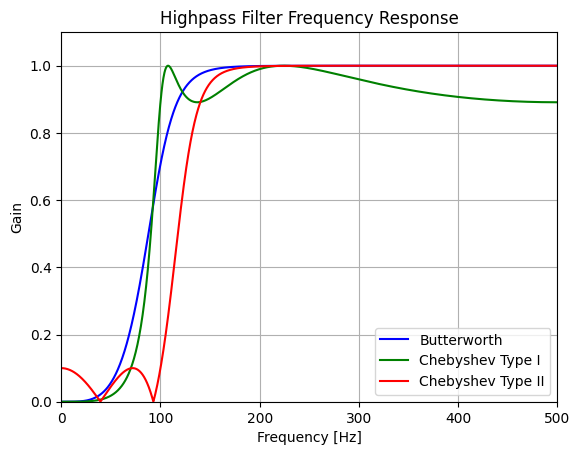

In [14]:
#IIR highpass sử dụng Butterworth và ChebysevI, Chebysev2...(Vẽ trên cùng hình....)
#Code here....
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, cheby1, cheby2, freqz

# Function to calculate and plot the frequency response of the filter
def plot_filter_response(b, a, label, color):
    w, h = freqz(b, a, worN=2000)
    # Convert from rad/sample to Hz
    plt.plot(w * (fs / (2 * np.pi)), np.abs(h), color=color, label=label)

# Filter parameters
fs = 1000  # Sampling frequency
fc = 100   # Cut-off frequency
order = 4  # Filter order

# Butterworth filter
b_butter, a_butter = butter(order, fc / (0.5 * fs), btype='high', analog=False)
plot_filter_response(b_butter, a_butter, 'Butterworth', 'b')

# Chebyshev Type I filter
b_cheby1, a_cheby1 = cheby1(order, 1, fc / (0.5 * fs), btype='high', analog=False)
plot_filter_response(b_cheby1, a_cheby1, 'Chebyshev Type I', 'g')

# Chebyshev Type II filter
b_cheby2, a_cheby2 = cheby2(order, 20, fc / (0.5 * fs), btype='high', analog=False)
plot_filter_response(b_cheby2, a_cheby2, 'Chebyshev Type II', 'r')

# Configure the plot
plt.title('Highpass Filter Frequency Response')
plt.xlabel('Frequency [Hz]')  # Now the x-axis is in Hz
plt.ylabel('Gain')
plt.grid()
plt.legend(loc='best')
plt.ylim(0, 1.1)
plt.xlim(0, fs / 2)  # Limit x-axis to Nyquist frequency (fs / 2)
plt.show()



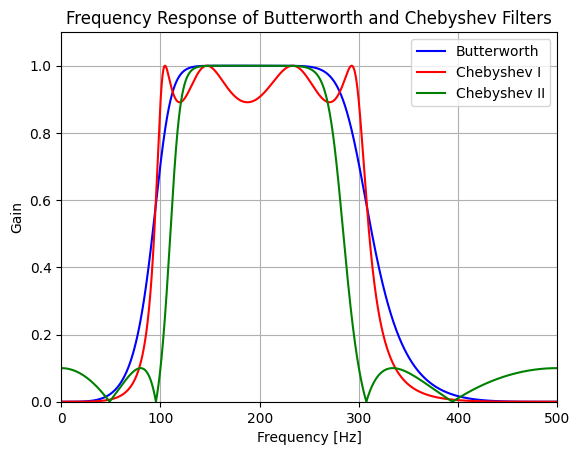

In [ ]:
#IIR bandpass sử dụng Butterworth và ChebysevI, Chebysev2...(Vẽ trên cùng hình....)
#Code here....
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, cheby1, cheby2, freqz

# Define filter parameters
fs = 1000  # Sampling frequency
nyq = 0.5 * fs  # Nyquist frequency
lowcut = 100.0  # Low cut-off frequency
highcut = 300.0  # High cut-off frequency

# Function to calculate and plot frequency response
def plot_filter_response(b, a, label, color):
    w, h = freqz(b, a, worN=8000)
    plt.plot(0.5 * fs * w / np.pi, np.abs(h), label=label, color=color)

# Create Butterworth filter
b_butter, a_butter = butter(4, [lowcut / nyq, highcut / nyq], btype='band')
plot_filter_response(b_butter, a_butter, 'Butterworth', 'blue')

# Create Chebyshev Type I filter
b_cheby1, a_cheby1 = cheby1(4, 1, [lowcut / nyq, highcut / nyq], btype='band')
plot_filter_response(b_cheby1, a_cheby1, 'Chebyshev I', 'red')

# Create Chebyshev Type II filter
b_cheby2, a_cheby2 = cheby2(4, 20, [lowcut / nyq, highcut / nyq], btype='band')
plot_filter_response(b_cheby2, a_cheby2, 'Chebyshev II', 'green')  # Default color

# Configure the plot
plt.title('Frequency Response of Butterworth and Chebyshev Filters')
plt.xlabel('Frequency [Hz]')
plt.ylabel('Gain')
plt.grid()
plt.legend()
plt.ylim(0, 1.1)
plt.xlim(0, 500)
plt.show()


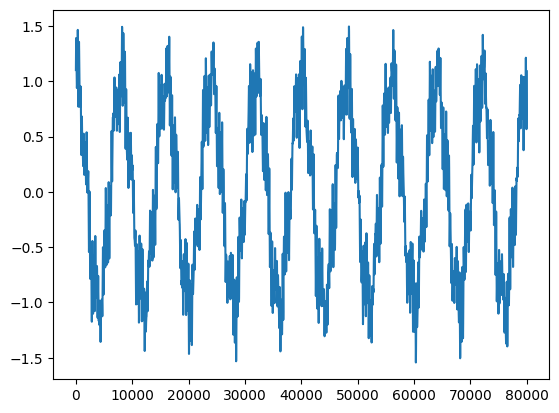

In [ ]:
# Để tính lối ra của tín hiệu khi đi qua hệ thống:
# Ta có thể sử dụng hàm lfilter hoặc theo cách tính convolution:
import numpy as np
from matplotlib.pyplot import plot, show
from numpy import cos, sin, pi
nsamples = 400
t = np.arange(0,20,1/fs)
x = cos(2*pi*0.5*t) + 0.2*sin(2*pi*2.5*t+0.1) + \
        0.2*sin(2*pi*15.3*t) + 0.1*sin(2*pi*16.7*t + 0.1) + \
            0.1*sin(2*pi*23.45*t+.8)
plot(x)
show()

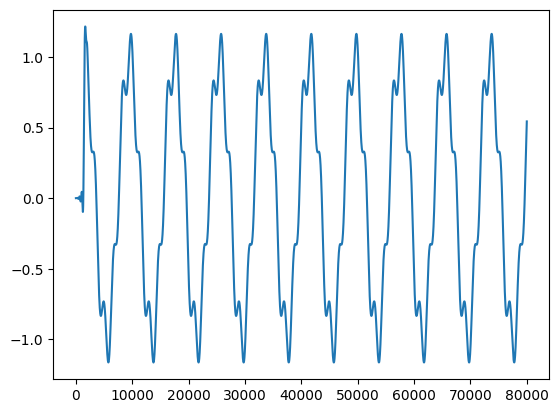

In [ ]:
# Tính toán lối ra bộ lọc
# Use lfilter to filter x with the FIR filter.
filtered_x = lfilter(h, 1.0, x)
plot(filtered_x)
show()

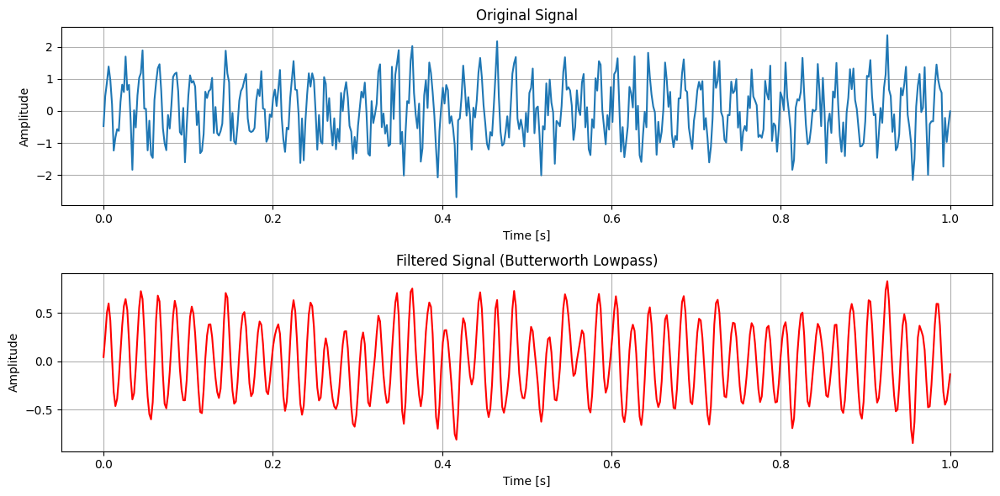

In [15]:
# Code sử dụng covolution......
# Xem thêm cách sử dụng ở đây:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, cheby1, cheby2, freqz
from numpy import convolve

# Function to create a Butterworth lowpass filter
def butter_lowpass(cutoff, fs, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return b, a

# Function to create a Chebyshev Type I lowpass filter
def cheby1_lowpass(cutoff, fs, order=5, rp=0.5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = cheby1(order, rp, normal_cutoff, btype='low', analog=False)
    return b, a

# Function to create a Chebyshev Type II lowpass filter
def cheby2_lowpass(cutoff, fs, order=5, rs=20):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = cheby2(order, rs, normal_cutoff, btype='low', analog=False)
    return b, a

# Function to apply the filter to a signal using convolution
def apply_filter_convolution(data, b):
    return convolve(data, b, mode='same')

# Example usage
fs = 500.0  # Sampling frequency
cutoff = 100.0  # Cut-off frequency
order = 6  # Filter order

# Create a sample signal (sine wave + noise)
t = np.linspace(0, 1.0, int(fs))
signal = np.sin(2 * np.pi * 50 * t) + 0.5 * np.random.normal(size=t.shape)


# Create the Butterworth lowpass filter
b, a = butter_lowpass(cutoff, fs, order)

# Calculate the impulse response
w, h = freqz(b, a, worN=2000)
impulse_response = np.zeros(2000)
impulse_response[0] = 1  # Impulse input

# Calculate the output using convolution
filtered_signal = apply_filter_convolution(signal, b)

# Display the results
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.plot(t, signal, label='Original Signal')
plt.title('Original Signal')
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')
plt.grid()

plt.subplot(2, 1, 2)
plt.plot(t, filtered_signal, label='Filtered Signal', color='red')
plt.title('Filtered Signal (Butterworth Lowpass)')
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')
plt.grid()

plt.tight_layout()
plt.show()


#Phần 2: Thiết kế bộ EQ

EQ đơn giản là một hệ gồm các bộ lọc thông dải song song nhau, đầu ra của mỗi bộ lọc được nhân thêm hệ số Gain. Thay đổi Gain, có thể thay đổi độ lớn của mỗi dải tần tương ứng ở đầu ra bộ lọc.
Trong phần đầu tiên, ta chỉ kiểm tra ảnh hưởng và cơ chế hoạt động của EQ bằng cách chia âm thanh thành các 10 hoặc 30 dải tần (như trong slide); các giá trị gain có thể được tuỳ chỉnh. Xác định âm thanh đầu ra tương ứng.

In [ ]:
# Để tiện cho xử lý các file âm thanh lớn, ta có thể sử dụng một số thư viện chuyên dụng cho đọc, ghi các file âm thanh.
# Bên dưới là một ví dụ. SV có thể chọn thư viện khác ....

In [17]:
!pip install pydub

In [ ]:
from pydub import AudioSegment
audio = AudioSegment.from_file('file.m4a')

In [3]:
from pydub import AudioSegment
from pydub.playback import play
from IPython.display import Audio

def apply_equalization(audio_segment, gains, num_bands=10):
    # Define the center frequencies for the bands
    if num_bands == 10:
        # Frequency bands for num_bands = 10
        freqs = [40, 80, 160, 320, 640, 1280, 2560, 5120, 10240, 20480]  
    elif num_bands == 30:
        # Frequency bands for num_bands = 30
        freqs = [20, 30, 40, 60, 80, 100, 125, 150, 200, 250,
                  315, 400, 500, 630, 800, 1000, 1250, 1600,
                  2000, 2500, 3150, 4000, 5000, 6300, 8000,
                  10000, 12500, 16000, 20000, 25000, 30000]  
    else:
        raise ValueError("num_bands must be either 10 or 30")

    # Create a list of resulting audio segments for each band
    output_segments = []

    for i, freq in enumerate(freqs):
        # Apply band-pass filter with corresponding gain
        band = audio_segment.low_pass_filter(freq) if i == 0 else audio_segment.high_pass_filter(freqs[i-1])
        band = band.high_pass_filter(freq) if i < len(freqs) - 1 else band
        band = band + gains[i]  # Apply gain
        output_segments.append(band)

    # Combine all bands into a single audio segment
    output_audio = sum(output_segments)
    return output_audio

# Read the audio file
input_file = "birds_singing.wav"  # Path to your WAV file
audio = AudioSegment.from_wav(input_file)

# Gain values for each band (can be adjusted)
gains = [-1, -5, 3, -7, 1, 9, -3, 5, 7, -2]  # 10 gain values for 10 frequency bands

# Apply equalization
output_audio = apply_equalization(audio, gains, num_bands=10)

# Save the processed audio
output_audio.export("output.wav", format="wav")

# Play the resulting audio
Audio('output.wav')


#Phần 2b (Mở rộng): Thiết kế bộ EQ cho phép xử lý tín hiệu trong thời gian thực
Tìm hiểu phương pháp hay cách thức để thực hiện bộ EQ cho tín hiệu âm thanh dài, trong đó,mỗi khi thay đổi hệ số bộ EQ thì âm thanh cũng thay đổi theo đó.
Phần này có thể sử dụng cho dự án cuối khoá sau này, nên SV có thể tìm hiểu dần...

#Phần 3: Xử lý, tạo hiệu ứng âm thanh trong miền thời gian
SV có thể đọc thêm ở https://sound.eti.pg.gda.pl/student/eim/synteza/adamx/eindex.html để hiểu thêm về bài thực hành

**Tạo hiệu ứng tiếng vọng Echo:**

Echo là hiệu ứng âm thanh tương ứng với trễ âm thanh ở đầu vào. Âm thanh lối ra **y(n) = x(n) + k.x(n-D)**; trong đó D là độ trễ, k là hệ số suy giảm. Lưu ý, để có hiệu ứng echo độ trễ D phải lớn, thông thường D = [td*fs], trong độ thời gian trễ td>100ms để cảm nhận được; fs=44,1kHz nên D>4410

Để tạo hiệu ứng Echo, ta sử dụng phương trình sai phân bên trên. x(n) là tín hiệu âm thanh còn x(n-D) là phiên bản trễ của nó. Nói cách khác về mặt cộng tín hiệu ta cộng x với phiên bản dịch D bước của nó.

Một cách khác là sử dụng lọc: biến đổi Z cho phương trình sai phân bên trên từ đó thu được hàm truyền $H(z) =1 + kz^{-D} $

Do đó, đáp ứng xung của hệ thống là $h=[1, 0, 0,...., 0, k]$ trong đó ta có D =4410 số 0 ở giữa.

C:\Users\Huy Anh\AppData\Local\Temp\ipykernel_9140\2497248933.py:19: WavFileWarning: Chunk (non-data) not understood, skipping it.
  sample_rate, data = wavfile.read('birds_singing.wav')


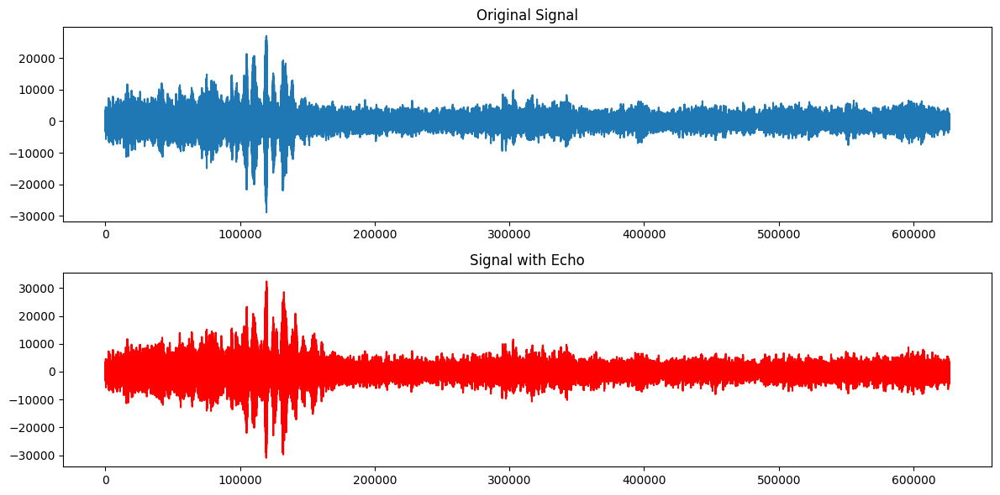

In [5]:
# Cách 1: Cộng tín hiệu
# Code here
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import wavfile

# Function to create an echo effect
def add_echo(signal, sample_rate, delay, decay):
    delay_samples = int(delay * sample_rate)
    echo_signal = np.zeros(len(signal) + delay_samples)

    # Add the original signal to the echo signal
    echo_signal[:len(signal)] += signal
    echo_signal[delay_samples:delay_samples + len(signal)] += decay * signal

    return echo_signal[:len(signal)]

# Read the audio file
sample_rate, data = wavfile.read('birds_singing.wav')

# If the signal is stereo, take only the first channel
if data.ndim > 1:
    data = data[:, 0]

# Parameters for echo
delay = 0.5  # Delay (seconds)
decay = 0.6  # Decay factor

# Create echo effect
echoed_data = add_echo(data, sample_rate, delay, decay)

# Save the result to a file
wavfile.write('output_echo.wav', sample_rate, echoed_data.astype(np.int16))

# Display the original signal and the signal with echo
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.title('Original Signal')
plt.plot(data)
plt.subplot(2, 1, 2)
plt.title('Signal with Echo')
plt.plot(echoed_data,'red')
plt.tight_layout()
plt.show()


C:\Users\Huy Anh\AppData\Local\Temp\ipykernel_9140\2210136855.py:8: WavFileWarning: Chunk (non-data) not understood, skipping it.
  sample_rate, data = wav.read('birds_singing.wav')


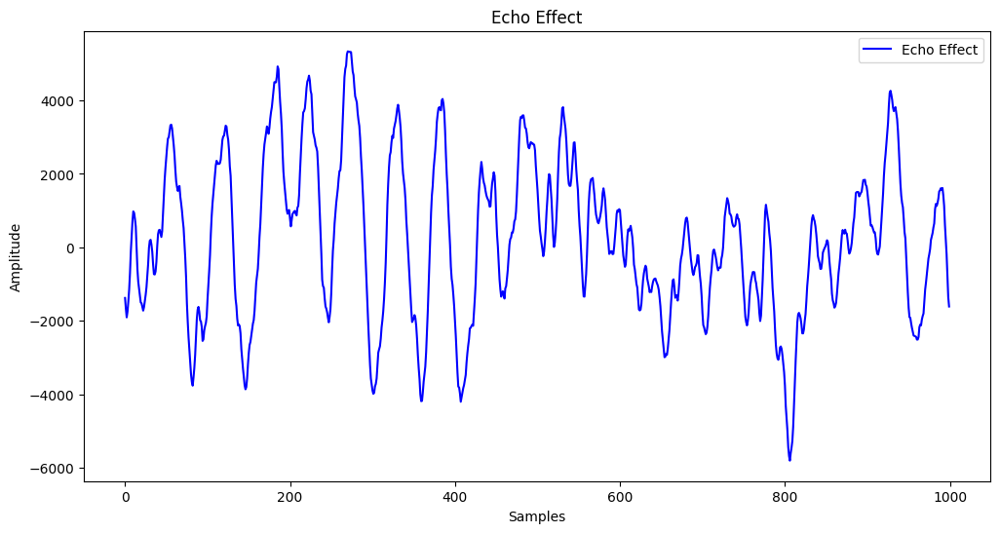

In [6]:
# Cách 2: Dùng bộ lọc:
# Code here
import numpy as np
import scipy.io.wavfile as wav
import matplotlib.pyplot as plt

# Read the audio file
sample_rate, data = wav.read('birds_singing.wav')

# If the audio is stereo, convert it to mono
if len(data.shape) > 1:
    data = data.mean(axis=1)

# Set parameters for the echo effect
delay = 0.2  # Delay time (seconds)
alpha = 0.5  # Gain factor for the echo

# Calculate the number of samples for the delay
delay_samples = int(sample_rate * delay)

# Create a new data array with enough length to hold the echo
echo_data = np.zeros(len(data) + delay_samples)

# Add the original audio
echo_data[:len(data)] += data

# Add the echo effect
echo_data[delay_samples:delay_samples + len(data)] += alpha * data

# Ensure values are within the range [-32768, 32767] for WAV format
echo_data = np.clip(echo_data, -32768, 32767).astype(np.int16)

# Save the new audio file
wav.write('output_echo1.wav', sample_rate, echo_data)

# Plot to visualize the effect
plt.figure(figsize=(12, 6))
plt.plot(echo_data[:1000],'blue', label='Echo Effect')
plt.legend()
plt.title('Echo Effect')
plt.xlabel('Samples')
plt.ylabel('Amplitude')
plt.show()


Khi có nhiều đường phản xạ, ta có thể mô tả nó bằng hệ thống IIR: Phương trình của hệ thống có dạng $ y(n) = x(n) +ky(n-D)$ hoặc hàm truyền $H(z) =\frac{1}{1 - kz^{-D}} $  
Theo cách này, ta có thể sử dụng phương pháp thiết kế bộ lọc IIR để mô tả hiện tượng tiếng vọng đa đường (Chọn D lớn).

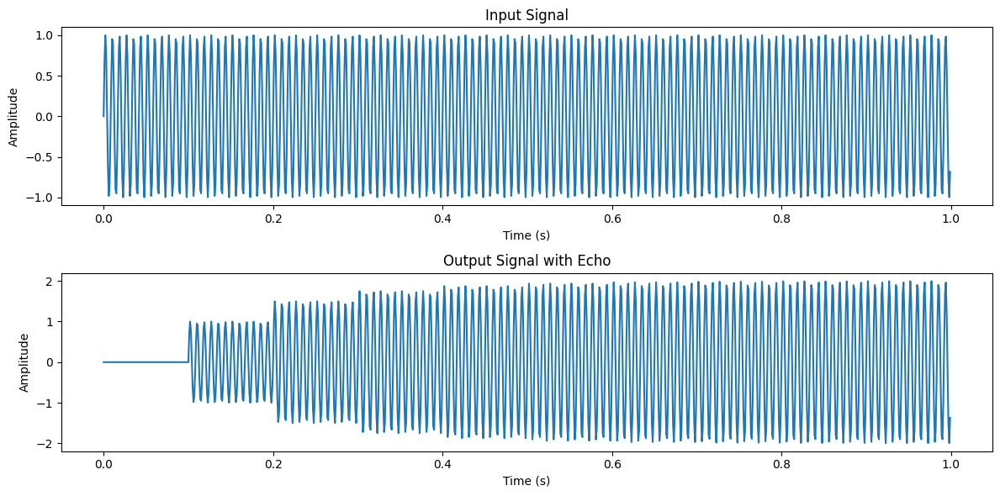

In [7]:
# Code here ....
import numpy as np
import matplotlib.pyplot as plt

# Set parameters
fs = 1000  # Sampling frequency (Hz)
D = 100    # Delay (number of samples)
k = 0.5    # Gain factor for the echo
duration = 1  # Duration (seconds)

# Create input signal (e.g., sine wave)
t = np.arange(0, duration, 1/fs)
frequency = 120  # Frequency of the sine wave (Hz)
x = np.sin(2 * np.pi * frequency * t)

# Initialize output signal
y = np.zeros_like(x)

# Calculate the output signal based on the system equation
for n in range(D, len(x)):
    y[n] = x[n] + k * y[n - D]

# Plot the signals
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.title('Input Signal')
plt.plot(t, x)
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')

plt.subplot(2, 1, 2)
plt.title('Output Signal with Echo')
plt.plot(t, y)
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')

plt.tight_layout()
plt.show()


**Tạo hiệu ứng tiếng vang Reverb**

Tiếng vang là hiện tượng âm thanh khi truyền trong các môi trường nhỏ hẹp, bị phản xạ trở lại, hoà lẫn với âm vừa phát ra xong. Lượng phản xạ này lớn đến mức tai người không thể cảm nhận được thời điểm. Để mô tả hiện tượng dội âm, người ta thường sử dụng các cấu trúc lọc IIR $H(z) =\frac{1}{1 - kz^{-D}} $ , với D nhỏ hoặc kết hợp với All-pass filter $H(z) =\frac{-k +z^{-D}}{1 - kz^{-D}} $

In [9]:
pip install soundfile


     ---------------------------------------- 0.0/1.0 MB ? eta -:--:--
     ---------------------------------------- 0.0/1.0 MB ? eta -:--:--
     ---------------------------------------- 0.0/1.0 MB ? eta -:--:--
     - -------------------------------------- 0.0/1.0 MB 217.9 kB/s eta 0:00:05
     - -------------------------------------- 0.0/1.0 MB 217.9 kB/s eta 0:00:05
     - -------------------------------------- 0.0/1.0 MB 217.9 kB/s eta 0:00:05
     - -------------------------------------- 0.0/1.0 MB 217.9 kB/s eta 0:00:05
     - -------------------------------------- 0.0/1.0 MB 217.9 kB/s eta 0:00:05
     - -------------------------------------- 0.0/1.0 MB 217.9 kB/s eta 0:00:05
     - -------------------------------------- 0.0/1.0 MB 217.9 kB/s eta 0:00:05
     - -------------------------------------- 0.0/1.0 MB 217.9 kB/s eta 0:00:05
     - -------------------------------------- 0.0/1.0 MB 217.9 kB/s eta 0:00:05
     - -------------------------------------- 0.0/1.0 MB 217.9 kB/s


[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: C:\Users\Huy Anh\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


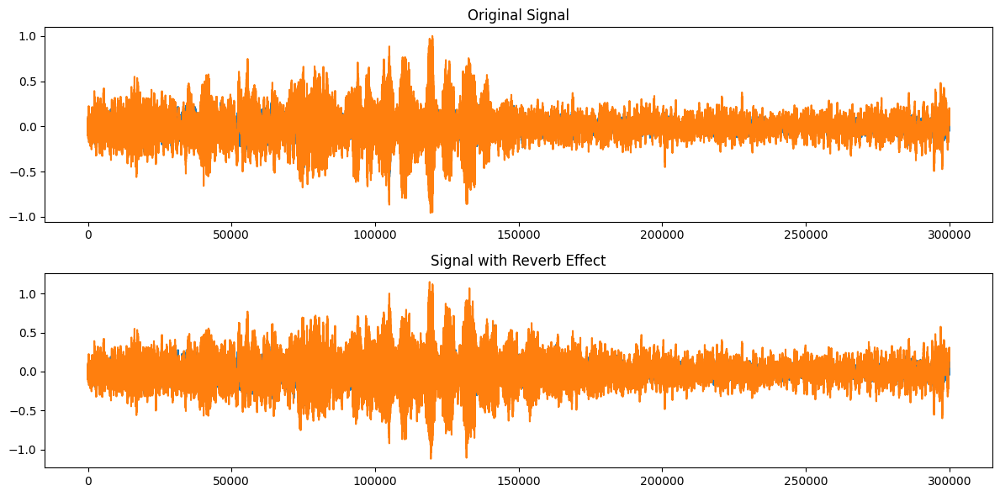

In [12]:
import numpy as np
import soundfile as sf
import matplotlib.pyplot as plt
from IPython.display import Audio

"""
    Create a reverb effect for the input signal.

    :param input_signal: Numpy array containing the audio signal
    :param k: Gain factor for the reverb
    :param D: Delay (number of samples)
    :return: Processed audio signal with reverb
"""

def reverb(input_signal, k, D):
    # Check the size of the signal
    if input_signal.ndim > 1:
        # If the signal is stereo, process each channel
        output_signal = np.zeros_like(input_signal)
        for channel in range(input_signal.shape[1]):
            output_signal[:, channel] = apply_reverb(input_signal[:, channel], k, D)
    else:
        # If the signal is mono
        output_signal = apply_reverb(input_signal, k, D)

    return output_signal

def apply_reverb(signal, k, D):
    output_signal = np.zeros(len(signal))
    for n in range(len(signal)):
        output_signal[n] = signal[n]
        if n >= D:
            output_signal[n] += k * output_signal[n - D]
    return output_signal

# Read the audio signal from a file
input_file = 'birds_singing.wav'  # Change the path to your audio file
output_file = 'output_reverb.wav'
input_signal, sample_rate = sf.read(input_file)

# Reverb parameters
k = 0.5  # Gain factor
D = int(0.5 * sample_rate)  # Delay, e.g., for 0.5 seconds at a sample rate of 44100 Hz

# Create reverb effect
output_signal = reverb(input_signal, k, D)

# Save the processed signal to a file
sf.write(output_file, output_signal, sample_rate)

# Display the original and processed signal plots
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.title('Original Signal')
plt.plot(input_signal[0:300000])
plt.subplot(2, 1, 2)
plt.title('Signal with Reverb Effect')
plt.plot(output_signal[0:300000])
plt.tight_layout()
plt.show()

Audio('output_reverb.wav')


C:\Users\Huy Anh\AppData\Local\Temp\ipykernel_9140\3961481087.py:21: WavFileWarning: Chunk (non-data) not understood, skipping it.
  sample_rate, audio_data = wav.read('birds_singing.wav')


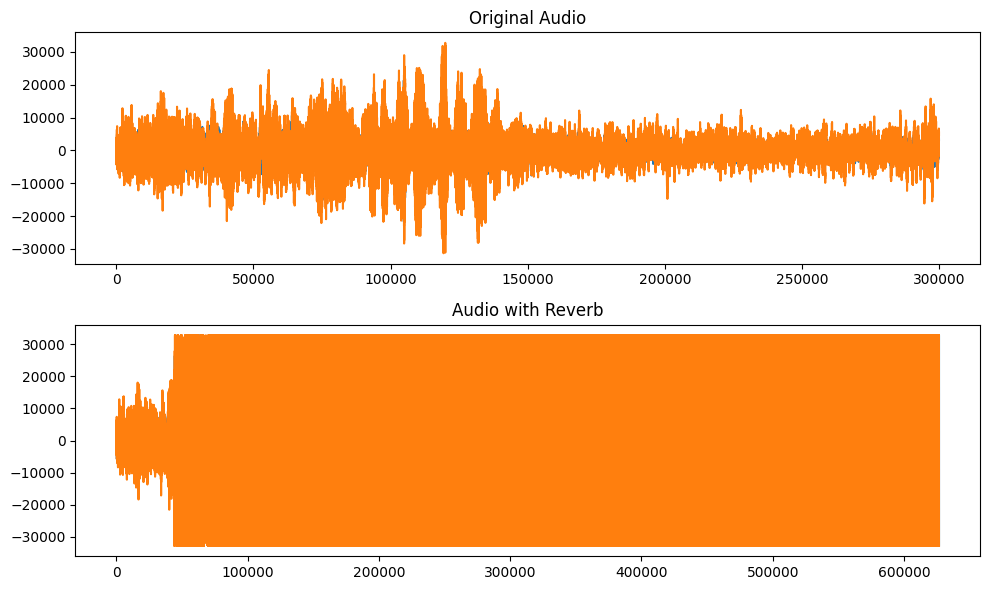

In [14]:
# Sử dụng IIR +All pass filter
# Code here....
import numpy as np
import scipy.io.wavfile as wav
import matplotlib.pyplot as plt
from IPython.display import Audio

# Function to create a reverb effect using an all-pass filter
def all_pass_reverb(signal, k, D):
    output = np.zeros_like(signal)

    for n in range(len(signal)):
        if n < D:
            output[n] = signal[n]
        else:
            output[n] = (signal[n] - k * output[n - D]) / (1 - k)

    return output

# Read the audio file
sample_rate, audio_data = wav.read('birds_singing.wav')

# Convert to float format
audio_data = audio_data.astype(float)

# If the audio has multiple channels, process each channel
if audio_data.ndim == 1:  # Mono
    reverb_audio = all_pass_reverb(audio_data, k=0.7, D=44100)
else:  # Stereo
    reverb_audio = np.zeros_like(audio_data)
    for i in range(audio_data.shape[1]):
        reverb_audio[:, i] = all_pass_reverb(audio_data[:, i], k=0.7, D=44100)

# Ensure output is within the range [-32768, 32767] for WAV file
reverb_audio = np.clip(reverb_audio, -32768, 32767)

# Convert back to int16 format
reverb_audio = reverb_audio.astype(np.int16)

# Save the processed audio
wav.write('output_reverb_1.wav', sample_rate, reverb_audio)

# Display the waveforms of the original and processed audio
plt.figure(figsize=(10, 6))
plt.subplot(2, 1, 1)
plt.title('Original Audio')
plt.plot(audio_data[0:300000])
plt.subplot(2, 1, 2)
plt.title('Audio with Reverb')
plt.plot(reverb_audio)
plt.tight_layout()
plt.show()

Audio('birds_singing.wav')


**Mở rộng: **

Thuật toán "Schroeder Reverb" được giới thiệu năm 1972 là một phương pháp nổi tiếng mô tả hiện tượng reverb trong môi trường đặc biệt như nhà thờ, nhà hát...
Cấu trúc bộ lọc "Schroeder Reverb" được giới thiệu ở đây https://www.youtube.com/watch?v=k1SorBkeqlo
Ngoài ra có thể đọc thêm ở đây https://users.utcluj.ro/~atn/papers/ATN_4_2011_10.pdf

Các em có thể tìm hiểu thêm và thực hiện thuật toán này


In [ ]:
# Room Reverb
# Nếu có đáp ứng xung mô tả âm thanh được truyền trong Nhà hát hay nhà thờ, chúng ta có thể tạo âm thanh giống như thế không?
# Ta có thể thử với file này xem ....








**Mô phỏng hiệu ứng Chorus và Flanger**


Đọc trong tài liệu tham khảo....:)


**Mô phỏng hiện tượng Phaser và wah-wah**

**Mô phỏng Tremolo**

**Mô phỏng âm thanh Chipsmusk và Autopus  với resampling.**

Pytorch Audio là 1 thư viện có nhiều hàm hỗ trợ cho xử lý âm thanh. Các em có thể đọc thêm ở đây https://pytorch.org/audio/stable/tutorials/effector_tutorial.html?highlight=audio+effect để biết cách tạo các hiệu ứng âm thanh với API có sẵn

In [ ]:
!pip install  torch
!pip install torchaudio
!pip install torchsummary
!pip install torchmetrics


In [ ]:
# Code cho các hiệu ứng âm thanh dùng Torch Audio.....

# Code here....

import torch
import torchaudio
from torchaudio.io import AudioEffector, CodecConfig

import matplotlib.pyplot as plt
from IPython.display import Audio



In [ ]:
src = torchaudio.utils.download_asset("tutorial-assets/Lab41-SRI-VOiCES-src-sp0307-ch127535-sg0042.wav")
waveform, sr = torchaudio.load(src, channels_first=False)

100%|██████████| 106k/106k [00:00<00:00, 5.76MB/s]


In [ ]:
def show(effect, *, stereo=False):
    wf = torch.cat([waveform] * 2, dim=1) if stereo else waveform
    figsize = (6.4, 2.1 if stereo else 1.2)

    effector = AudioEffector(effect=effect, pad_end=False)
    result = effector.apply(wf, int(sr))

    num_channels = result.size(1)
    f, ax = plt.subplots(num_channels, 1, squeeze=False, figsize=figsize, sharex=True)
    for i in range(num_channels):
        ax[i][0].specgram(result[:, i], Fs=sr)
    f.set_tight_layout(True)

    return Audio(result.numpy().T, rate=sr)

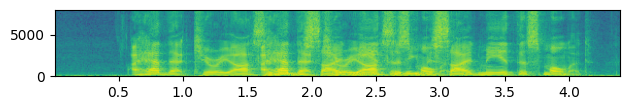

In [ ]:
show("aecho=in_gain=0.5:out_gain=0.88:delays=1000:decays=0.3")